# Deadly Visualizations!!!

![Image](../images/viz_types_portada.png)

## Setup

First we need to create a basic setup which includes:

- Importing the libraries.

- Reading the dataset file (source [Instituto Nacional de Estadística](https://www.ine.es/ss/Satellite?L=es_ES&c=Page&cid=1259942408928&p=1259942408928&pagename=ProductosYServicios%2FPYSLayout)).

- Create a couple of columns and tables for the analysis.

__NOTE:__ some functions were already created in order to help you go through the challenge. However, feel free to perform any code you might need.

In [151]:
# some imports

import sys
sys.path.insert(0, "../modules")
import pandas as pd
import cufflinks as cf
import plotly.express as px
import re
import module as mod # functions are include in module.py.
cf.go_offline()
import matplotlib.pyplot as plt   # conda install matplotlib
import matplotlib as mpl
import seaborn as sns

In [8]:
# read dataset

deaths = pd.read_csv('../data/7947.csv', sep=';', thousands='.')

deaths

,Causa de muerte,Sexo,Edad,Periodo,Total
0,001-102 I-XXII.Todas las causas,Total,Todas las edades,2018,427721
1,001-102 I-XXII.Todas las causas,Total,Todas las edades,2017,424523
2,001-102 I-XXII.Todas las causas,Total,Todas las edades,2016,410611
3,001-102 I-XXII.Todas las causas,Total,Todas las edades,2015,422568
4,001-102 I-XXII.Todas las causas,Total,Todas las edades,2014,395830
...,...,...,...,...,...
301153,102 Otras causas externas y sus efectos tardíos,Mujeres,95 y más años,1984,0
301154,102 Otras causas externas y sus efectos tardíos,Mujeres,95 y más años,1983,0
301155,102 Otras causas externas y sus efectos tardíos,Mujeres,95 y más años,1982,0
301156,102 Otras causas externas y sus efectos tardíos,Mujeres,95 y más años,1981,0


In [9]:
# add some columns...you'll need them later

deaths['cause_code'] = deaths['Causa de muerte'].apply(mod.cause_code)
deaths['cause_group'] = deaths['Causa de muerte'].apply(mod.cause_types)
deaths['cause_name'] = deaths['Causa de muerte'].apply(mod.cause_name)

deaths.head()

,Causa de muerte,Sexo,Edad,Periodo,Total,cause_code,cause_group,cause_name
0,001-102 I-XXII.Todas las causas,Total,Todas las edades,2018,427721,001-102,Multiple causes,I-XXII.Todas las causas
1,001-102 I-XXII.Todas las causas,Total,Todas las edades,2017,424523,001-102,Multiple causes,I-XXII.Todas las causas
2,001-102 I-XXII.Todas las causas,Total,Todas las edades,2016,410611,001-102,Multiple causes,I-XXII.Todas las causas
3,001-102 I-XXII.Todas las causas,Total,Todas las edades,2015,422568,001-102,Multiple causes,I-XXII.Todas las causas
4,001-102 I-XXII.Todas las causas,Total,Todas las edades,2014,395830,001-102,Multiple causes,I-XXII.Todas las causas


In [4]:
# lets check the categorical variables

var_list = ['Sexo', 'Edad', 'Periodo', 'cause_code', 'cause_name', 'cause_group']

categories = mod.cat_var(deaths, var_list)
categories

,categorical_variable,number_of_possible_values,values
0,cause_code,117,"[001-102, 001-008, 001, 002, 003, 004, 005, 00..."
1,cause_name,117,"[I-XXII.Todas las causas, I.Enfermedades infec..."
2,Periodo,39,"[2018, 2017, 2016, 2015, 2014, 2013, 2012, 201..."
3,Edad,22,"[Todas las edades, Menos de 1 año, De 1 a 4 añ..."
4,Sexo,3,"[Total, Hombres, Mujeres]"
5,cause_group,2,"[Multiple causes, Single cause]"


In [26]:
categories["values"][5]

array(['Multiple causes', 'Single cause'], dtype=object)

In [5]:
# we need also to create a causes table for the analysis

causes_table = deaths[['cause_code', 'cause_name']].drop_duplicates().sort_values(by='cause_code').reset_index(drop=True)

causes_table

,cause_code,cause_name
0,001,Enfermedades infecciosas intestinales
1,001-008,I.Enfermedades infecciosas y parasitarias
2,001-102,I-XXII.Todas las causas
3,002,Tuberculosis y sus efectos tardíos
4,003,Enfermedad meningocócica
...,...,...
112,098,Suicidio y lesiones autoinfligidas
113,099,Agresiones (homicidio)
114,100,Eventos de intención no determinada
115,101,Complicaciones de la atención médica y quirúrgica


In [6]:
# And some space for free-style Pandas!!! (e.g.: df['column_name'].unique())








## Lets make some transformations

Eventhough the dataset is pretty clean, the information is completely denormalized as you could see. For that matter a collection of methods (functions) are available in order to generate the tables you might need:

- `row_filter(df, cat_var, cat_values)` => Filter rows by any value or group of values in a categorical variable.

- `nrow_filter(df, cat_var, cat_values)` => The same but backwards. 

- `groupby_sum(df, group_vars, agg_var='Total', sort_var='Total')` => Add deaths by a certain variable.

- `pivot_table(df, col, x_axis, value='Total')`=> Make some pivot tables, you might need them...

__NOTE:__ be aware that the filtering methods can perform a filter at a time. Feel free to perform the filter you need in any way you want or feel confortable with.

In [12]:
# Example 1
dataset = mod.row_filter(deaths, 'Sexo', ['Total'])
dataset = mod.row_filter(dataset, 'Edad', ['Todas las edades'])
dataset.head()

,Causa de muerte,Sexo,Edad,Periodo,Total,cause_code,cause_group,cause_name
0,001-102 I-XXII.Todas las causas,Total,Todas las edades,2018,427721,001-102,Multiple causes,I-XXII.Todas las causas
1,001-102 I-XXII.Todas las causas,Total,Todas las edades,2017,424523,001-102,Multiple causes,I-XXII.Todas las causas
2,001-102 I-XXII.Todas las causas,Total,Todas las edades,2015,422568,001-102,Multiple causes,I-XXII.Todas las causas
3,001-102 I-XXII.Todas las causas,Total,Todas las edades,2016,410611,001-102,Multiple causes,I-XXII.Todas las causas
4,001-102 I-XXII.Todas las causas,Total,Todas las edades,2012,402950,001-102,Multiple causes,I-XXII.Todas las causas


In [59]:
deaths["Edad"]

0         Todas las edades
1         Todas las edades
2         Todas las edades
3         Todas las edades
4         Todas las edades
                ...       
301153       95 y más años
301154       95 y más años
301155       95 y más años
301156       95 y más años
301157       95 y más años
Name: Edad, Length: 301158, dtype: object

In [13]:
# Example 2
group = ['cause_code','Periodo']
dataset = mod.groupby_sum(deaths, group)
dataset.head()

,cause_code,Periodo,Total
0,001-102,2018,1710884
1,001-102,2017,1698092
2,001-102,2015,1690272
3,001-102,2016,1642444
4,001-102,2012,1611800


In [14]:
# Example 3

dataset = mod.pivot_table(dataset, 'cause_code', 'Periodo')
dataset.head()

cause_code,Periodo,001,001-008,001-102,002,003,004,005,006,007,...,093,094,095,096,097,098,099,100,101,102
0,1980,1620,15768,1157376,5904,2008,3448,436,0,0,...,4956,1432,184,692,16748,6608,1496,28,968,96
1,1981,1404,15124,1173544,6332,1656,3344,348,0,0,...,4700,1200,156,1396,17472,6872,1284,336,908,208
2,1982,1308,13488,1146620,5352,1240,3104,316,0,0,...,4864,956,200,1000,18616,7404,1228,440,1132,52
3,1983,1212,13100,1210276,5152,1072,3152,336,0,0,...,4788,1464,148,884,18392,8724,1560,1276,1500,56
4,1984,1228,12928,1197636,4564,964,3704,424,0,0,...,4716,1244,164,1020,14696,9972,1812,1144,1636,76


## ...and finally, show me some insights with Plotly!!!

Of course, you can always check the [class notes](https://github.com/ih-datapt-mad/dataptmad1121_lessons/tree/main/module-2) for further info. 

In [34]:
# Cufflinks histogram

#deaths.iplot(kind='hist', x="Edad", y="Total", title='VIZ TITLE',yTitle='AXIS TITLE', xTitle='AXIS TITLE')

In [107]:
deaths_alvaro = mod.row_filter(deaths, 'Sexo', ['Hombres', "Mujeres"])
deaths_alvaro = deaths_alvaro.drop(deaths_alvaro.loc[(deaths_alvaro["Edad"]=='Todas las edades')].index, axis=0)
def replace_edad(x):
    y = x.strip()
    return y
def replace_total(x):
    y = x.strip()
    return int(y)
deaths_alvaro["Edad"] = deaths_alvaro["Edad"].apply(replace_edad)
#deaths_alvaro["Total"] = deaths_alvaro["Total"].apply(replace_total)
deaths_alvaro = deaths_alvaro.reset_index(drop=True)
deaths_alvaro = deaths_alvaro.drop(deaths_alvaro.loc[(deaths_alvaro["cause_name"]=='I-XXII.Todas las causas')].index, axis=0).reset_index(drop=True)
deaths_alvaro

,Causa de muerte,Sexo,Edad,Periodo,Total,cause_code,cause_group,cause_name
0,053-061 IX.Enfermedades del sistema circulatorio,Mujeres,De 85 a 89 años,1998,18466,053-061,Multiple causes,IX.Enfermedades del sistema circulatorio
1,053-061 IX.Enfermedades del sistema circulatorio,Mujeres,De 85 a 89 años,1999,18432,053-061,Multiple causes,IX.Enfermedades del sistema circulatorio
2,053-061 IX.Enfermedades del sistema circulatorio,Mujeres,De 85 a 89 años,2012,18373,053-061,Multiple causes,IX.Enfermedades del sistema circulatorio
3,053-061 IX.Enfermedades del sistema circulatorio,Mujeres,De 85 a 89 años,2015,18371,053-061,Multiple causes,IX.Enfermedades del sistema circulatorio
4,053-061 IX.Enfermedades del sistema circulatorio,Mujeres,De 85 a 89 años,1997,18018,053-061,Multiple causes,IX.Enfermedades del sistema circulatorio
...,...,...,...,...,...,...,...,...
190003,027 Tumores malignos de otros órganos genital...,Hombres,De 65 a 69 años,1983,0,027,Single cause,Tumores malignos de otros órganos genitales fe...
190004,027 Tumores malignos de otros órganos genital...,Hombres,De 65 a 69 años,1984,0,027,Single cause,Tumores malignos de otros órganos genitales fe...
190005,078 Enfermedades de los órganos genitales mas...,Hombres,De 55 a 59 años,1989,0,078,Single cause,Enfermedades de los órganos genitales masculinos
190006,027 Tumores malignos de otros órganos genital...,Hombres,De 65 a 69 años,1985,0,027,Single cause,Tumores malignos de otros órganos genitales fe...


In [95]:
px.histogram(data_frame=deaths_alvaro, x='Edad', y="Total")

In [96]:
px.histogram(data_frame=deaths_alvaro, x='Sexo', y="Total")

In [165]:
deaths_alvaro_yayos = mod.row_filter(deaths_alvaro, 'Edad', ["De 85 a 89 años", "De 80 a 84 años", "De 90 a 94 años"])
deaths_alvaro_yayos = deaths_alvaro_yayos.loc[(deaths_alvaro_yayos["Total"] > 2000)]
deaths_alvaro_yayos_mujer = deaths_alvaro_yayos.loc[(deaths_alvaro_yayos["Sexo"] == "Mujeres")]
deaths_alvaro_yayos_hombres = deaths_alvaro_yayos.loc[(deaths_alvaro_yayos["Sexo"] == "Hombres")]
deaths_alvaro_yayos_hombres.head()

,Causa de muerte,Sexo,Edad,Periodo,Total,cause_code,cause_group,cause_name
93,053-061 IX.Enfermedades del sistema circulatorio,Hombres,De 85 a 89 años,2017,12191,053-061,Multiple causes,IX.Enfermedades del sistema circulatorio
96,053-061 IX.Enfermedades del sistema circulatorio,Hombres,De 80 a 84 años,2005,11789,053-061,Multiple causes,IX.Enfermedades del sistema circulatorio
98,053-061 IX.Enfermedades del sistema circulatorio,Hombres,De 85 a 89 años,2018,11772,053-061,Multiple causes,IX.Enfermedades del sistema circulatorio
101,053-061 IX.Enfermedades del sistema circulatorio,Hombres,De 85 a 89 años,2015,11568,053-061,Multiple causes,IX.Enfermedades del sistema circulatorio
102,053-061 IX.Enfermedades del sistema circulatorio,Hombres,De 80 a 84 años,2007,11530,053-061,Multiple causes,IX.Enfermedades del sistema circulatorio


In [166]:
#plt.subplots(nrows=1, ncols=1,figsize=(12, 14))

px.histogram(data_frame=deaths_alvaro_yayos, x='cause_name', y="Total",width=1000, height=1100,title='Más de 1000 muertes por año de personas mayores de 80 años')

In [171]:
px.histogram(data_frame=deaths_alvaro_yayos_mujer, x='cause_name', y= "Total",width=1000, height=1100,title='Más de 1000 muertes por año de mujeres mayores de 80 años')


In [172]:
px.histogram(data_frame=deaths_alvaro_yayos_hombres, x='cause_name', y= "Total",width=1000, height=1100,title='Más de 1000 muertes por año de personas mayores de 80 años')


In [212]:
deaths_alvaro_full_yayos = deaths_alvaro_yayos[["cause_name", "Sexo", "Total"]]
px.histogram(data_frame=deaths_alvaro_yayos, x='cause_name',y="Total",width=1000, height=1200,title='Más de 1000 muertes por año de personas mayores de 80 años',color="Sexo", barmode="group")

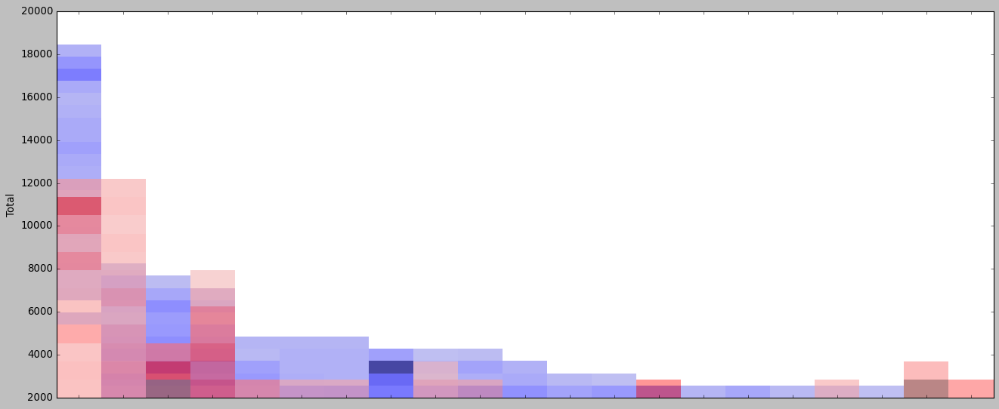

In [177]:
fig, ax =  plt.subplots(nrows=1, ncols=1,figsize=(20, 8))
plt.style.use("classic")
d1 = sns.histplot(x="cause_name", y="Total", data=deaths_alvaro_yayos_mujer, label = "mujeres")
d2 = sns.histplot(x="cause_name", y="Total", data=deaths_alvaro_yayos_hombres, color= "red", label = "hombres",alpha=.6)
d2.set(xticklabels=[])
d2.set(xlabel=None)
d1.set(xticklabels=[])
d1.set(xlabel=None)
plt.show()

In [180]:
deaths_alvaro_full = deaths_alvaro.loc[(deaths_alvaro["Total"] > 3000)]
deaths_alvaro_full_mujer = deaths_alvaro_full.loc[(deaths_alvaro_full["Sexo"] == "Mujeres")]
deaths_alvaro_full_hombres = deaths_alvaro_full.loc[(deaths_alvaro_full["Sexo"] == "Hombres")]
deaths_alvaro_full_hombres.head()

,Causa de muerte,Sexo,Edad,Periodo,Total,cause_code,cause_group,cause_name
100,053-061 IX.Enfermedades del sistema circulatorio,Hombres,De 85 a 89 años,2017,12191,053-061,Multiple causes,IX.Enfermedades del sistema circulatorio
105,053-061 IX.Enfermedades del sistema circulatorio,Hombres,De 80 a 84 años,2005,11789,053-061,Multiple causes,IX.Enfermedades del sistema circulatorio
107,053-061 IX.Enfermedades del sistema circulatorio,Hombres,De 85 a 89 años,2018,11772,053-061,Multiple causes,IX.Enfermedades del sistema circulatorio
110,009-041 II.Tumores,Hombres,De 75 a 79 años,2009,11642,009-041,Multiple causes,II.Tumores
112,009-041 II.Tumores,Hombres,De 75 a 79 años,2010,11571,009-041,Multiple causes,II.Tumores


In [182]:
px.histogram(data_frame=deaths_alvaro_full, x='cause_name', y="Total",width=1000, height=800,title='Más de 5000 muertes por año del total de personas')

In [186]:
px.histogram(data_frame=deaths_alvaro_full_mujer, x='cause_name', y= "Total",width=1000, height=800,title='Más de 5000 muertes por año del total de  mujeres')

In [187]:
px.histogram(data_frame=deaths_alvaro_full_hombres, x='cause_name', y= "Total",width=1000, height=800,title='Más de 5000 muertes por año del total de hombres')

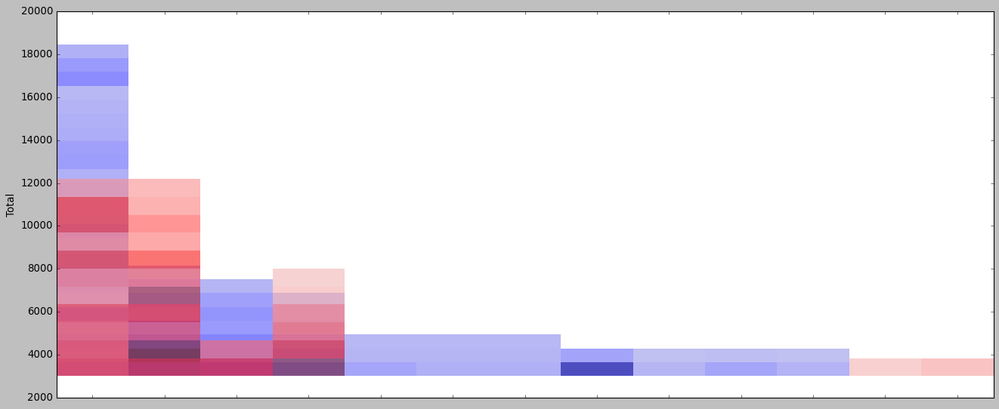

In [191]:
fig2, ax2 =  plt.subplots(nrows=1, ncols=1,figsize=(20, 8))
plt.style.use("classic")
d1x = sns.histplot(x="cause_name", y="Total", data=deaths_alvaro_full_mujer, label = "mujeres")
d2x = sns.histplot(x="cause_name", y="Total", data=deaths_alvaro_full_hombres, color= "red", label = "hombres",alpha=.6)
d2x.set(xticklabels=[])
d2x.set(xlabel=None)
d1x.set(xticklabels=[])
d1x.set(xlabel=None)
plt.show()

In [211]:
px.histogram(data_frame=deaths_alvaro_full2, x='cause_name', y="Total",width=1000, height=800,title='Más de 5000 muertes por año del total de personas',color="Sexo", barmode="group")

In [197]:
deaths_alvaro_full2 = deaths_alvaro_full[["cause_name", "Sexo", "Total"]]
deaths_alvaro_full2

,cause_name,Sexo,Total
0,IX.Enfermedades del sistema circulatorio,Mujeres,18466
1,IX.Enfermedades del sistema circulatorio,Mujeres,18432
2,IX.Enfermedades del sistema circulatorio,Mujeres,18373
3,IX.Enfermedades del sistema circulatorio,Mujeres,18371
4,IX.Enfermedades del sistema circulatorio,Mujeres,18018
...,...,...,...
1474,Insuficiencia cardíaca,Mujeres,3009
1475,X.Enfermedades del sistema respiratorio,Hombres,3009
1476,II.Tumores,Mujeres,3009
1477,"Tumor maligno de la tráquea, de los bronquios ...",Hombres,3009


In [170]:
# Cufflinks bar plot
'''
dataset_bar.iplot(kind='bar',
                  x='VARIABLE',
                  xTitle='AXIS TITLE',
                  yTitle='AXIS TITLE',
                  title='VIZ TITLE')
'''

"\ndataset_bar.iplot(kind='bar',\n                  x='VARIABLE',\n                  xTitle='AXIS TITLE',\n                  yTitle='AXIS TITLE',\n                  title='VIZ TITLE')\n"

In [ ]:
# Cufflinks line plot
'''
dataset_line.iplot(kind='line',
                   x='VARIABLE',
                   xTitle='AXIS TITLE',
                   yTitle='AXIS TITLE',
                   title='VIZ TITLE')
'''

In [ ]:
# Cufflinks scatter plot
'''
dataset_scatter.iplot(x='VARIABLE', 
                      y='VARIABLE', 
                      categories='VARIABLE',
                      xTitle='AXIS TITLE', 
                      yTitle='AXIS TITLE',
                      title='VIZ TITLE')
'''